In [81]:
import networkx as nx
import matplotlib.pyplot as plt
from gurobipy import *
from itertools import combinations
import heapq as hq
from random import sample
import pandas as pd
import math
import csv
import numpy as np


from sklearn.cluster import SpectralClustering
from sklearn import metrics
import operator

import warnings
warnings.filterwarnings("ignore")

plt.rcParams['figure.figsize'] = [6, 4] ## set the size of all figures

# Table of contents

2. Question 2
    - [Question 2a](#Question2a)
    - [Question 2b](#Question2b)
3. Question 3
    - [Question 3a](#Question3a)
    - [Question 3b](#Question3b)
    - [Question 3c](#Question3c)
4. Question 4
    - [Question 4a](#Question4a)
    - [Question 4b](#Question4b)

# Question 2.a<a name = "Question2a"></a>
### create a final graph

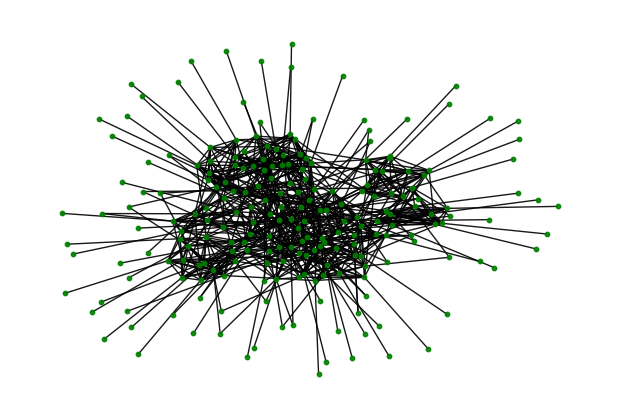

In [98]:
# Draw a original graph
G=nx.read_edgelist("games.csv", data = False,  delimiter = ",")

pos=nx.spring_layout(G)
nx.draw(G,pos, node_size=10,  node_color='green', alpha = 0.9, edge_color = "black", width = 1)

In [99]:
# Create a degree >=10 graph 
H=G.copy()

import operator

threshold = 10/(len(list(G.nodes()))-1)

removeEdges=[]

deg = nx.degree_centrality(H)

for deg_node in deg:
    if deg[deg_node] < threshold:
        H.remove_node(deg_node)
        for (i,j) in H.edges():
            if i == deg_node:
                H.remove_edge(deg_node,j)
                
                removeEdges.append((deg_node,j))
            elif j == deg_node:
                H.remove_edge(i,deg_node)
                removeEdges.append((i,deg_node))

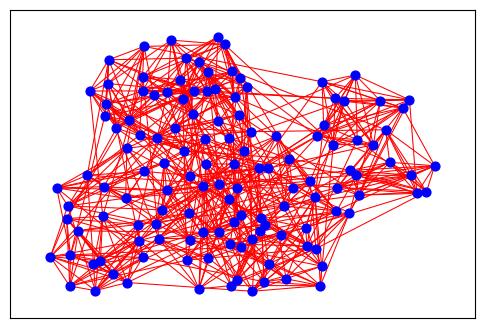

In [100]:
center=[i for i in H.nodes()]
edges=[(i,j) for (i,j) in H.edges()]

# nx.draw(G, pos, node_size=30, width=0.5, alpha=0.3)
nx.draw_networkx_nodes(G, pos, nodelist=center, node_color='b', node_size=40)
nx.draw_networkx_edges(G, pos, edgelist=edges, edge_color='r', width=0.75)

### 1. Iterative bipartitioning based on the Fiedler vector

0.24724897355391856


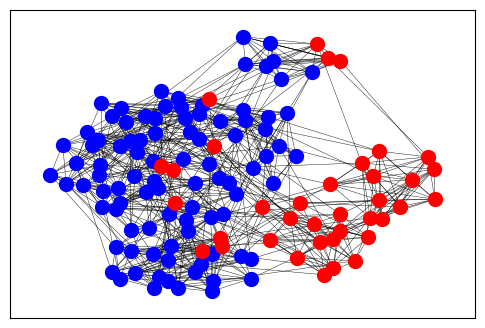

In [85]:
H2=H.copy()


secondEigen=nx.fiedler_vector(H2)
nodes={}
counter=0
for i in H2.nodes():
    nodes[i]=secondEigen[counter]
    counter+=1
    
    
for (i,d) in H2.nodes(data=True):
    if nodes[i] < 0:
        d['color']='blue'
    else:
        d['color']='red'

blueNodes=[i for (i,d) in H2.nodes(data=True) if d['color']=='blue']
redNodes=[i for (i,d) in H2.nodes(data=True) if d['color']=='red']
nx.draw_networkx_nodes(H2, pos, blueNodes, node_size=100, node_color='blue')
nx.draw_networkx_nodes(H2, pos, redNodes, node_size=100, node_color='red')
nx.draw_networkx_edges(H2, pos, width=0.3)

import networkx.algorithms.community as nx_communities
print(nx_communities.modularity(H2,[redNodes, blueNodes]))

In [86]:
print(blueNodes)
print(redNodes)

['Florida', 'Miami', 'Kentucky', 'Tennessee', 'Auburn', 'LSU', 'South Carolina', 'Georgia', 'Vanderbilt', 'Missouri', 'Florida State', 'North Carolina', 'Central Michigan', 'Virginia Tech', 'Virginia', 'Georgia Tech', 'Pittsburgh', 'Louisville', 'Florida International', 'Duke', 'Bowling Green', 'Kansas State', 'Louisiana Tech', 'Kent State', 'Notre Dame', 'Toledo', 'Western Michigan', 'Akron', 'Miami (OH)', 'Ohio', 'Buffalo', 'Penn State', 'Liberty', 'Temple', 'Eastern Michigan', 'Ohio State', 'Marshall', 'UCF', 'East Carolina', 'Connecticut', 'South Florida', 'Memphis', 'Illinois', 'Indiana', 'Tulane', 'UMass', 'Florida Atlantic', 'Western Kentucky', 'UAB', 'Old Dominion', 'Charlotte', 'Arkansas', 'Southern Mississippi', 'Middle Tennessee', 'Appalachian State', 'Clemson', 'North Texas', 'UTEP', 'Texas A&M', 'Syracuse', 'Boston College', 'NC State', 'Wake Forest', 'SMU', 'South Alabama', 'Rice', 'UT San Antonio', 'Texas State', 'Alabama', 'Ole Miss', 'Mississippi State', 'Georgia State

### 2. Girvan-newman method

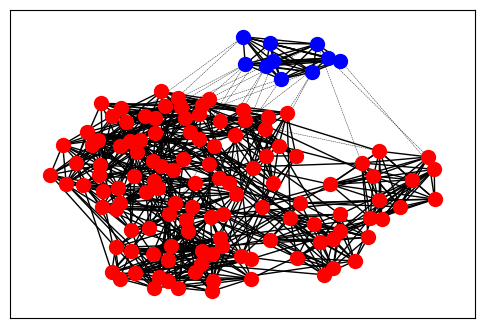

In [87]:
H2=H.copy()

import operator

removeEdges=[]

while nx.is_connected(H2):
    ebet=nx.edge_betweenness_centrality(H2)
    maxEdge=max(ebet, key=ebet.get)
    if maxEdge in H2.edges():
        H2.remove_edge(maxEdge[0],maxEdge[1])
        removeEdges.append((maxEdge[0],maxEdge[1]))
    else:
        H2.remove_edge(maxEdge[1],maxEdge[0])
        removeEdges.append((maxEdge[1],maxEdge[0]))

components=nx.connected_components(H2)
x=[c for c in sorted(nx.connected_components(H2), key=len, reverse=True)]


redNodes=[i for (i,d) in H2.nodes(data=True) if i in x[0]]
blueNodes=[i for (i,d) in H2.nodes(data=True) if i in x[1]]
nx.draw_networkx_nodes(H2, pos, blueNodes, node_size=100, node_color='blue')
nx.draw_networkx_nodes(H2, pos, redNodes, node_size=100, node_color='red')
nx.draw_networkx_edges(H2, pos, width=1)
nx.draw_networkx_edges(H2, pos, width=0.3, edgelist=removeEdges, style='--')

In [88]:
print(blueNodes)
print(redNodes)

['Texas Tech', 'Kansas State', 'Oklahoma', 'Texas', 'Baylor', 'Oklahoma State', 'TCU', 'Iowa State', 'Kansas', 'West Virginia']
['Florida', 'Miami', 'Kentucky', 'Tennessee', 'Auburn', 'LSU', 'South Carolina', 'Georgia', 'Vanderbilt', 'Missouri', 'Florida State', 'North Carolina', 'Central Michigan', 'Virginia Tech', 'Virginia', 'Georgia Tech', 'Pittsburgh', 'Louisville', 'Florida International', 'Duke', "Hawai'i", 'Arizona', 'Oregon State', 'Washington', 'Nevada', 'Boise State', 'Air Force', 'New Mexico', 'Fresno State', 'San José State', 'UNLV', 'San Diego State', 'Army', 'UCLA', 'Colorado', 'USC', 'Stanford', 'Oregon', 'Utah', 'Arizona State', 'Bowling Green', 'Louisiana Tech', 'Kent State', 'Notre Dame', 'Toledo', 'Western Michigan', 'Akron', 'Miami (OH)', 'Ohio', 'Buffalo', 'Penn State', 'Liberty', 'Temple', 'Eastern Michigan', 'Cincinnati', 'Ohio State', 'Marshall', 'UCF', 'Houston', 'Tulsa', 'East Carolina', 'Connecticut', 'South Florida', 'Memphis', 'Washington State', 'Californ

### 3. Louvain clustering method

In [89]:
H2=H.copy()

# Every node is its own community initially.
communities=[]
for i in H.nodes():
    communities.append([i])
    
# Printing the initial modularity:
import networkx.algorithms.community as nx_comm
print(nx_comm.modularity(H, communities))

-0.007708723282212307


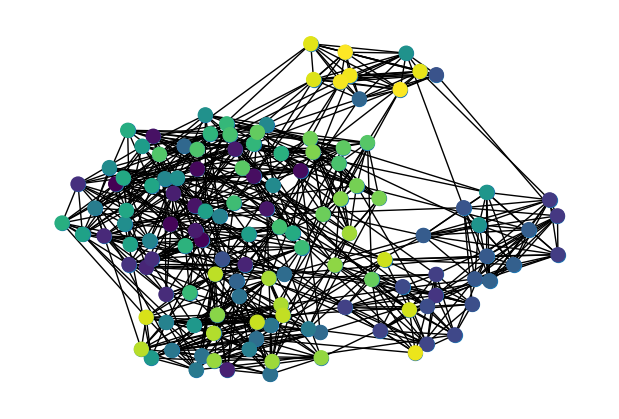

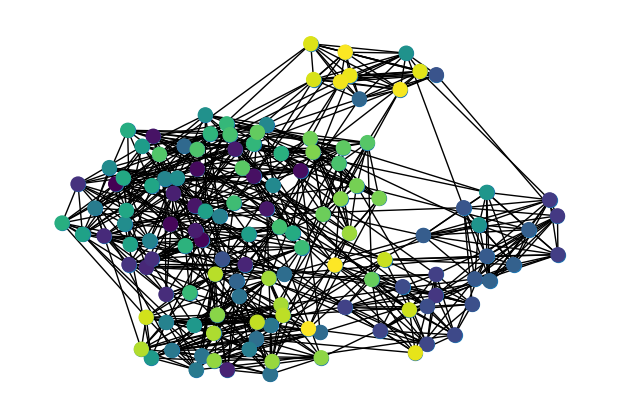

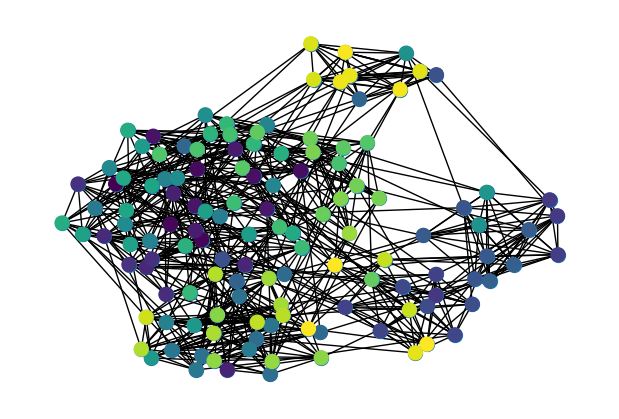

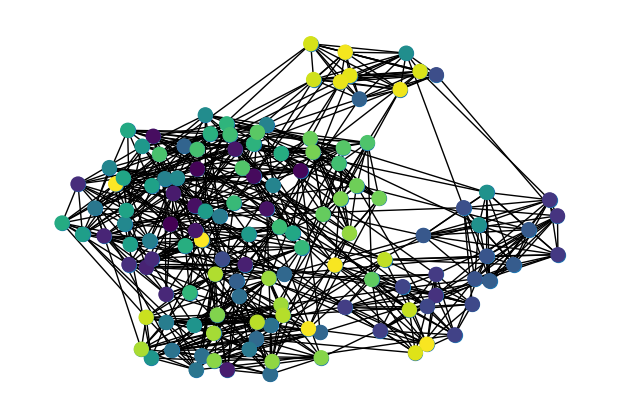

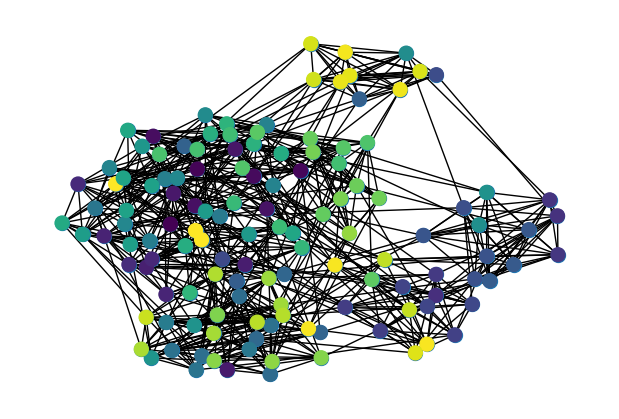

...

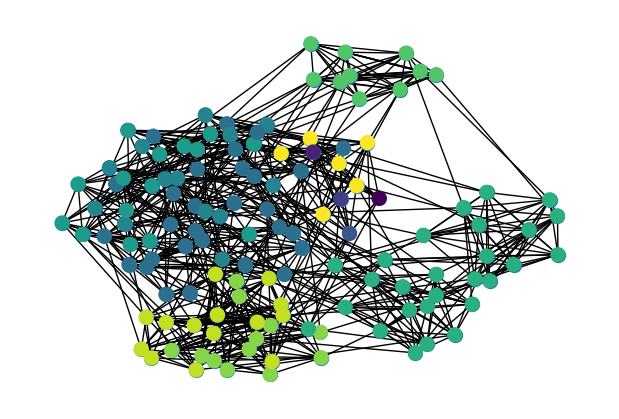

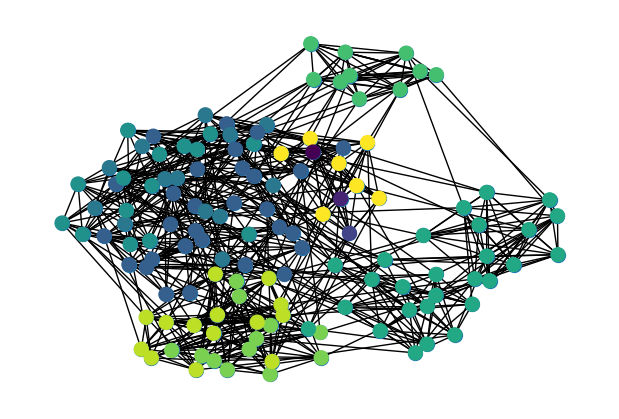

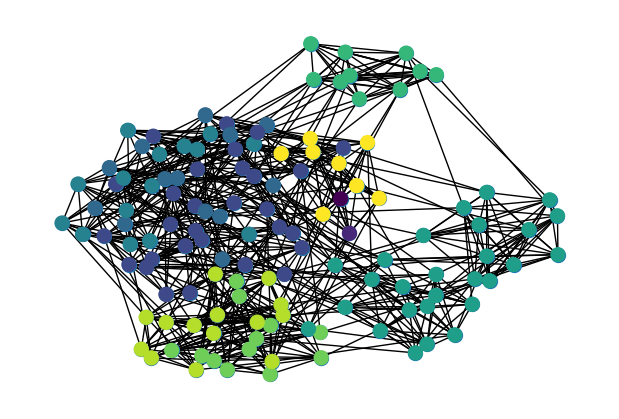

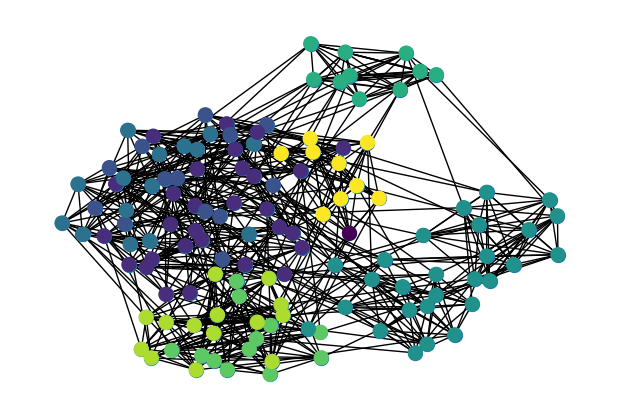

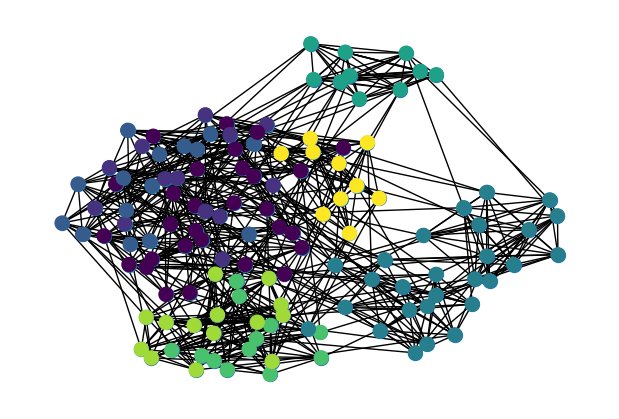

In [90]:
import networkx.algorithms.community as nx_comm
import matplotlib.pyplot as plt

iteration=0
maxModularity=30
prevModularity=nx_comm.modularity(H2, communities)
while maxModularity>0:
    nx.draw(H2, pos, node_size=100)
    colors=[]
    for i in H2.nodes():
        for j in range(len(communities)):
            if i in communities[j]:
                colors.append(j)
    nodes=nx.draw_networkx_nodes(H, pos, nodelist=H2.nodes(), node_color=colors, node_size=100)
    plt.show()
    iteration+=1
    maxModularity=-1
    saveI=-1
    saveJ=-1
    for (i,j) in combinations(communities,2):
        communities2=[]
        for k in communities:
            if k!=i and k!=j:
                communities2.append(k)
        communities2.append(i+j)
        if nx_comm.modularity(H2,communities2)-prevModularity>maxModularity:
            maxModularity=nx_comm.modularity(H2,communities2)-prevModularity
            saveI=i
            saveJ=j
    if maxModularity>0:
        communities2=[]
        for k in communities:
            communities2.append(k)
        communities=[]
        for k in communities2:
            if k!=saveI and k!=saveJ:
                communities.append(k)
        communities.append(saveI+saveJ)
    prevModularity=nx_comm.modularity(H,communities)
    

<font size="4">From the above three curves, compared to the method1, method 2(Girvan-newman method) and method 3(Louvain clustering method) can specifically classified graph into the two seaparated clusters. And all the smaller clusters(blue node in the Girvan-newman method and green node(top-right nodes) in the Louvain clustering method) have geographical relationship. However, in the mehtod1, the smaller group(red node) abvious are not closed enough.</font>

<font size="4">Hence, the accuracy rate in the method 2 and the method 3 will be higher than using the method 1.</font>


# Question 2.b<a name = "Question2b"></a>
### Overlapping clusters: 

<font size="4">The method I will introduce is also called Clique percolation method(CPM). I reference it from the [wiki](https://en.wikipedia.org/wiki/Clique_percolation_method). But I will modified a little bit in order to find the maxmium overlapping cluster(max k-cliques).</font>

<font size="4">Before starting, I create a graph G.</font>

<font size="4">First of all, I will use the nx.simple_cycles(G)) to find all cycles. It will create all possible cycles. Then, I pick up cycles from the largest path of the cycles. If the largest path of the cycles in G is r, I try to connect two cycles together by if the two r-cycles commonly share r-1 nodes. Therefore, there will have several subgraphs are being formed. if two of those subgraphs share the same nodes, the same nodes are the overlapping clusters of the G in r-many cycles. The overall number of nodes is k</font>

<font size="4">Repeat the rule again in r-1 many cycles. if there are more overlapping clusters, replace the old ones. and update the new number k. Otherwise, keep the previous one. End when r-1 = k</font>

<font size="4">The pseudocode can be:</font>
<blockquote>
procedure
   
    G(V,E)
    cycles <- nx.simple_cycles(G))
    k <- 0
    r <- max(len(np.cycles))
    overlapping_cluster = ''
    while r-1 != k
         subgraph1 <- connect two cycles if r-1 nodes are shared 
         if two subgraph1 share the common nodes
            if the length of the common nodes < the length of the overlapping_cluster
                overlapping_cluster <- the common nodes
                k = len(overlapping_cluster)
         r -= 1
    return overlapping_cluster, k            
end procedure  
<blockquote>

# Question 3.a<a name = "Question3a"></a>

<font size="4">An all-negative signed graph is balanced if and only if it is bipartite. One of the examples can be like this: 
![signed-bipartite-network](Pictures/signed-bipartite-network.png)</font>

<font size="4">In the graph, the upper side red line contain 4 nodes and in this graph, it contains 4 negative path.</font>

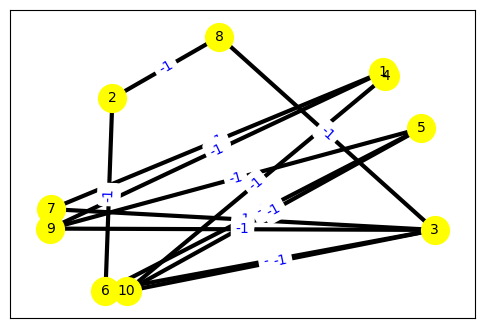

In [91]:
## Graph G
G = nx.Graph()

G.add_edge("1", "7", weight= -1)
G.add_edge("1", "9", weight= -1)
G.add_edge("2", "6", weight= -1)
G.add_edge("2", "8", weight= -1)
G.add_edge("3", "6", weight= -1)
G.add_edge("3", "7", weight= -1)
G.add_edge("3", "8", weight= -1)
G.add_edge("3", "9", weight= -1)
G.add_edge("3", "10", weight= -1)
G.add_edge("4", "10", weight= -1)
G.add_edge("5", "6", weight= -1)
G.add_edge("5", "9", weight= -1)
G.add_edge("5", "10", weight= -1)

elarge = [(u, v) for (u, v, d) in G.edges(data=True) ]
pos = nx.spring_layout(G)



# nodes
nx.draw_networkx_nodes(G, pos, node_size=400, node_color= "yellow")

# edges
nx.draw_networkx_edges(G, pos, edgelist=elarge, width=3)

# node labels
nx.draw_networkx_labels(G, pos, font_size=10, font_family="sans-serif")
# edge weight labels
edge_labels = nx.get_edge_attributes(G, "weight")
nx.draw_networkx_edge_labels(G, pos, edge_labels, font_size = 10, font_color= "blue")
plt.show()

# Question 3.b<a name = "Question3b"></a>

<font size="4">Q: Define a signed graph G. In G, there have two clusters, A, and B, which contain all weights that are positive. in the connection of A and B are all negative edges. prove it. </font>

<font size="4">A: All I want to prove is that I can not find a subgraph that contains odd negative edges. </font>

<font size="4">In graph G, if I want to create a cycle, I can create three different types of paths:</font>

1. <font color='blue'>**Type 1: a cycle is created inside the subgraph A** </font> 
   <br> $~~$ In type 1, no matter what cycle is created, the number of negative-weighted edges inside subgraph A can be only 0.</br>
2. <font color='blue'>**Type 2: a cycle is created inside the subgraph B.**  </font>
   <br> $~~$ In type 2, no matter what cycle is created, the number of negative weighted edges inside subgraph A can be only 0.</br>
3. <font color='blue'>**Type 3: a cycle that uses two negative-weighted connected edges.** </font>
   <br> $~~$ In type 3, no matter what cycle is created, the number of negative weighted edges inside the subgraph A+B can be only 2. Because the summary of the negative edge that is chosen inside subgraph A is equal to 0; the summary of the negative edge that is chosen inside the subgraph B is equal to 0; However, in the connection edge A $\rightarrow$ B or B $\rightarrow$ A, 2 negative weight will be chosen. Therefore, the overall negative edges used will be 2. </br>






<font size="4">Therefore, all possible cycles in graph G contain even negative edges. </font>

# Question 3.c<a name = "Question3c"></a>

1. <font size="4">Define <font color='blue'>delete_edge</font>  = $[]$</font> 
2. <font size="4">Find all cycles list(Using [DFS’s logic](https://www.baeldung.com/cs/cycles-undirected-graph)) </font> 
3. <font size="4">For each cycle, do:</font> 

    - Calculating the count of all negative edges.
    - divide by 2, and check the remainder:
            - if remainder = 1 --> if one of it is equal to 1, stop and return this is unbalanced graph
            - if remainder = 0 --> if all cycles' remainder is 0, return the cycle is balanced, and end searching
    - if one of cycles' remainder ==1, return unbalanced cycle edges list
    
    
4. <font size="4">Using greedy algorithm, listing all negative edges, start from #number ==1, while #number <= len(all negative edges):</font> 

    - Delete #number of edges (i,j) (if #number = 1, each time, choosing one edge to remove), repeat step2 to check remainder</font> 
        - If all remainder ==0, delete_edge append(i,j) and <font color='green'>report delete_edge</font> 
        - Remove another #number of edges (i,j) to check again
        - If all #number of edges (i,j) can not find signed graph(all cycles have a remainder equal to 0), #number +=1
            

Using above alorithm, we can finally find what negative edges we should remove in order to get a signed graph.

# Question 4.a<a name = "Question4a"></a>

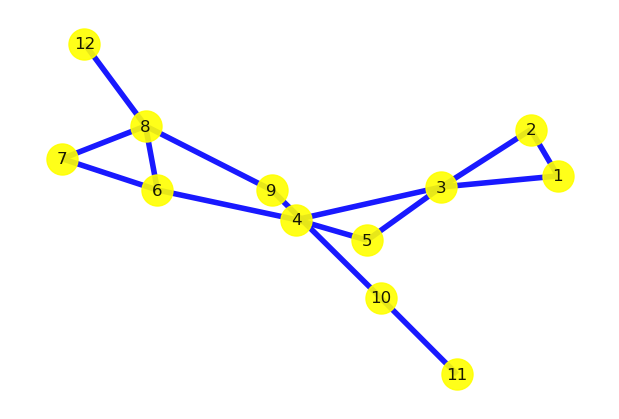

In [92]:
## Graph G
G = nx.Graph()
node_tuple = [(1,2), (1,3), (2,3), (3,4), (3,5), (4,5), (4,6), (6,7), (6,8), (7,8), (8,9), (8,12), (9,10), (10,11)]

G.add_edges_from(node_tuple)

G1 = G.copy()

pos=nx.spring_layout(G)
nx.draw(G,pos, with_labels=True, node_size=500,  node_color='yellow', alpha = 0.9, edge_color = "blue", width = 4)


In [93]:
def find_leader(G, G1, k = 2):
    if len(list(G1.nodes()))>2:
        bet=nx.betweenness_centrality(G1)
        first_high = sorted(bet.values(), reverse=True)[0]
        second_high = sorted(bet.values(), reverse=True)[1]
        if (first_high - second_high) >= 0.4:
            print("Find leader node: {} and its graph: {}.".format(list(bet.keys())[list(bet.values()).index(first_high)], list(G1.nodes())))
        else:
            adj_mat = nx.to_numpy_matrix(G1)
            G_new=nx.from_numpy_matrix(adj_mat)
            
            sc = SpectralClustering(k, affinity='precomputed', n_init=100, assign_labels='discretize')
            sc.fit(adj_mat)
            
            
            separate = {}
            for j in range(k):
                add_nodes = []
                if j not in separate:
                    separate[j] = []
                    

                for i in range(len(G1.nodes())):
                    if sc.labels_[i]==j:
                        add_nodes.append(list(G1.nodes())[i])
                separate[j] = add_nodes
                
            for i in separate:
                H2 = G.subgraph(separate[i])
                find_leader(G, H2, k)
                
        
    else:
        print("Only two nodes remain. Subgraph:{}".format(list(G1.nodes())))

In [94]:
# Find the leader and its group
find_leader(G, G1, k = 2)

Find leader node: 10 and its graph: [9, 10, 11].
Find leader node: 8 and its graph: [8, 12, 6, 7].
Find leader node: 3 and its graph: [1, 2, 3, 4, 5].


# Question 4.b<a name = "Question4b"></a>

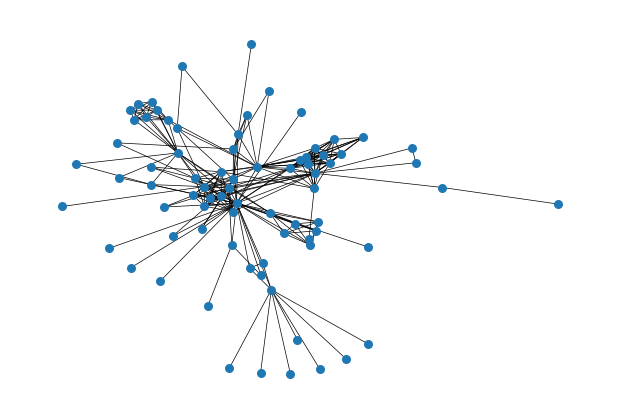

In [101]:
G = nx.les_miserables_graph()
pos=nx.spring_layout(G)
nx.draw(G, pos, node_size=30, width=0.5)

In [96]:
k=3
model=Model("max_k_plex")
dbar={}
x={}
for i in G.nodes():
    dbar[i]=G.number_of_nodes()-G.degree[i]-1
    x[i]=model.addVar(vtype=GRB.BINARY, obj=-1)

for i in G.nodes():
    model.addConstr(quicksum(x[j] for j in G.nodes() if (i,j) not in G.edges() and i!=j)<=(k-1)*x[i]+dbar[i]*(1-x[i]))

model.optimize()

Gurobi Optimizer version 10.0.0 build v10.0.0rc2 (win64)

CPU model: 11th Gen Intel(R) Core(TM) i7-11800H @ 2.30GHz, instruction set [SSE2|AVX|AVX2|AVX512]
Thread count: 8 physical cores, 16 logical processors, using up to 16 threads

Optimize a model with 77 rows, 77 columns and 5421 nonzeros
Model fingerprint: 0x541528d4
Variable types: 0 continuous, 77 integer (77 binary)
Coefficient statistics:
  Matrix range     [1e+00, 7e+01]
  Objective range  [1e+00, 1e+00]
  Bounds range     [1e+00, 1e+00]
  RHS range        [4e+01, 8e+01]
Found heuristic solution: objective -4.0000000
Presolve added 2 rows and 2 columns
Presolve time: 0.01s
Presolved: 79 rows, 79 columns, 4809 nonzeros
Variable types: 0 continuous, 79 integer (77 binary)

Root relaxation: objective -3.907512e+01, 96 iterations, 0.00 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

     0     0  -39.

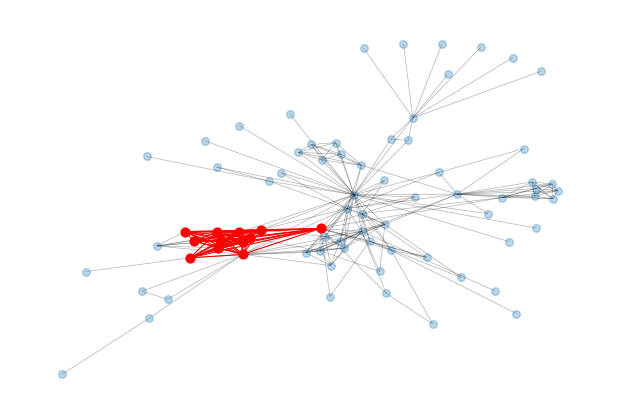

In [97]:
k_club_nodes=[i for i in G.nodes() if x[i].X==1]
k_club_edges=[(i,j) for (i,j) in G.edges() if i in k_club_nodes and j in k_club_nodes]

nx.draw(G, pos, node_size=30, width=0.5, alpha=0.3)
nx.draw_networkx_nodes(G, pos, nodelist=k_club_nodes, node_color='r', node_size=40)
nx.draw_networkx_edges(G, pos, edgelist=k_club_edges, edge_color='r', width=0.75)
